# Import libraries

In [1]:
# to read and wrangle data
import pandas as pd

# to create spatial data
import geopandas as gpd

# for charts
import plotly.express as px

# for basemaps
import contextily as ctx

# for interactive leaflet mapping
import folium

# to handle thousands of markers
from folium.plugins import MarkerCluster

# Analyze Conservation Easement Data

In [2]:
# Import Califrnia Conservation Easement Database shapefile

CCED = gpd.read_file('../data/CCED1/CCED_California_Conservation_Easement_Database.shp')
CCED.head()

,ease_label,sitename,esmthldr,eholdtyp,pubaccess,duration,comments,projectid,dtmboardap,county,...,s_emthd1,ShapeSTLen,OBJECTID,e_type,Shape_Leng,OBJECTID_1,Shape_Le_1,GlobalID,OBJECTID_2,geometry
0,Conservation Easement,Forest Service Easement,United States Forest Service,Federal,Closed,Permanent,None,None,None,San Diego,...,None,13904.975825,1,None,11677.376353,1,11677.376353,{47F27121-F8E0-464A-8460-257E4815EC72},1,MULTIPOLYGON Z (((-12986180.651 3863101.889 0....
1,Conservation Easement,Forest Service Easement,United States Forest Service,Federal,Closed,Permanent,None,None,None,San Diego,...,None,4682.317029,2,None,3906.326855,2,3906.326855,{4A76CAED-7EFA-4B3D-B60F-25077C8132F9},2,"POLYGON Z ((-13004703.942 3936729.412 0.000, -..."
2,Conservation Easement,Forest Service Easement,United States Forest Service,Federal,Closed,Permanent,None,None,None,Riverside,...,None,2862.369888,3,None,2381.546995,3,2381.546995,{4C17BE5C-00CE-456F-8CF0-259211A8DBA7},3,"POLYGON Z ((-12985843.064 3982453.578 0.000, -..."
3,Conservation Easement,Forest Service Easement,United States Forest Service,Federal,Closed,Permanent,None,None,None,San Bernardino,...,None,1702.694201,4,None,1406.940351,4,1406.940351,{A48635D1-6A10-419B-B5A2-12F0355E8EC5},4,"POLYGON Z ((-13046839.601 4059743.122 0.000, -..."
4,Conservation Easement,Forest Service Easement,United States Forest Service,Federal,Closed,Permanent,None,None,None,El Dorado,...,None,355.721294,5,None,276.692317,5,276.692317,{52689BFB-BBCA-4E4C-A224-6A334B158035},5,MULTIPOLYGON Z (((-13359781.503 4702478.829 0....


## Make Bar Charts

In [3]:
# want to start making a bar chart of what the types of easementholders are.
# look at the unique values and count how many each has, then reset the columns to not count the index

ease_by_type = CCED.eholdtyp.value_counts().reset_index()
ease_by_type.columns=['eholdtyp','count']
ease_by_type

,eholdtyp,count
0,Unknown,2617
1,NonProfit,2543
2,Private,2425
3,Association,1492
4,Federal,835
5,Special District,667
6,State,634
7,City,580
8,County,419
9,Government,73


In [4]:
# make a simple plotly express bar chart of the previous table 

px.bar(ease_by_type,
       x='eholdtyp',
       y='count',
       title='Types of Easementholders in CA',
       labels = {'eholdtyp':'Easement Type','count':'Count'}
      )

In [5]:
# start setting up the stacked bar chart
# use .count to see number of entries in each column by county
CCED.groupby(['county']).count()

# group the number of easements (use ease_label for the count) by easementholder type
by_county = CCED.groupby(['county','eholdtyp']).count()[['ease_label']]

# flatten the formatting 
by_county_flat = by_county.reset_index()

# check to make sure all the steps worked
by_county_flat

,county,eholdtyp,ease_label
0,Alameda,City,6
1,Alameda,County,1
2,Alameda,Federal,10
3,Alameda,NonProfit,93
4,Alameda,Special District,41
...,...,...,...
206,Yolo,Unknown,1
207,Yuba,Federal,7
208,Yuba,NonProfit,4
209,Yuba,State,10


In [6]:
# list the easementholders by count to find the ones with the most
# just use the original CCED dataframe for simplicity

CCED['county'].value_counts()

San Diego          7389
Sonoma              398
Nevada              347
Santa Cruz          332
Merced              260
Placer              245
Riverside           212
Marin               197
Napa                193
Los Angeles         184
Santa Clara         177
Alameda             167
Colusa              139
Yolo                138
El Dorado           113
Mendocino           112
Contra Costa        109
San Luis Obispo     107
Sacramento          101
Kern                100
San Mateo            92
Monterey             85
Butte                83
Tehama               72
Humboldt             70
Solano               68
Shasta               62
Tulare               61
Sutter               57
Stanislaus           47
San Joaquin          42
Fresno               40
Santa Barbara        40
Ventura              36
Orange               35
San Bernardino       34
Glenn                33
Modoc                27
Siskiyou             26
Calaveras            26
Sierra               26
Madera          

In [7]:
# exclude San Diego because it's a huge outlier, and only take the following 20 so we can actually tell whats in the bars
# make a list of San Diego and counties that are after the top 21 (all those after San Mateo)

row_drop = ['San Diego','Monterey','Butte','Tehama','Humboldt','Solano','Shasta','Tulare','Sutter','Stanislaus','San Joaquin','Santa Barbara','Fresno','Ventura','Orange','San Bernardino','Glenn','Modoc','Siskiyou','Calaveras','Sierra','Madera','Lassen','Mono','Yuba','Lake','Plumas','Mariposa','Amador','San Benito','Alpine','Imperial','Kings','Del Norte','Inyo','Tuolumne','Trinity','San Francisco']

# drop the rows from the row_drop list, make axis=0 because it's rows
by_county = by_county.drop(row_drop,axis=0)

# flatten and check the result
by_county_flat = by_county.reset_index()
by_county_flat

,county,eholdtyp,ease_label
0,Alameda,City,6
1,Alameda,County,1
2,Alameda,Federal,10
3,Alameda,NonProfit,93
4,Alameda,Special District,41
...,...,...,...
90,Yolo,City,12
91,Yolo,Federal,26
92,Yolo,NonProfit,94
93,Yolo,State,5


In [8]:
# make the stacked bar chart. relabel so the names in the chart do not have underscores or weird abbreviations

px.bar(by_county_flat,
       x='county',
       y='ease_label',
       color = 'eholdtyp',
       labels = {'county':'County','ease_label':'Count','eholdtyp':'type'},
       title = 'Easements by Holder Type in Top 20 CA Counties'
      )

# Make Maps

## Make Map of Counties' percent population in urban areas

It will be our base layer for a multi-layered interactive map

In [9]:
# Import urban and rural dataset
ur = pd.read_csv('../data/urb.rural.counties.csv')
ur.head()

,Geo_NAME,Geo_QName,Geo_AREALAND,Geo_AREAWATR,Geo_SUMLEV,Geo_GEOCOMP,Geo_REGION,Geo_DIVISION,Geo_FIPS,Geo_STATE,...,SF1_P0020002,SF1_P0020003,SF1_P0020004,SF1_P0020005,SF1_P0020006,PCT_SF1_P0020002,PCT_SF1_P0020003,PCT_SF1_P0020004,PCT_SF1_P0020005,PCT_SF1_P0020006
0,Alameda County,"Alameda County, California",1914046110,213184643,50,0,4,9,6001,6,...,1504402,1504402,0,5869,0,99.61,99.61,0.00,0.39,0
1,Alpine County,"Alpine County, California",1912271907,12557251,50,0,4,9,6003,6,...,0,0,0,1175,0,0.00,0.00,0.00,100.00,0
2,Amador County,"Amador County, California",1539962991,29456575,50,0,4,9,6005,6,...,15075,0,15075,23016,0,39.58,0.00,39.58,60.42,0
3,Butte County,"Butte County, California",4238423238,105325758,50,0,4,9,6007,6,...,178416,98176,80240,41584,0,81.10,44.63,36.47,18.90,0
4,Calaveras County,"Calaveras County, California",2641819725,43810420,50,0,4,9,6009,6,...,11208,0,11208,34370,0,24.59,0.00,24.59,75.41,0


In [10]:
# change data type

ur = pd.read_csv(
    '../data/urb.rural.counties.csv',
    dtype=
    {
        'Geo_FIPS':str,
        'Geo_STATE':str,
        'Geo_COUNTY': str
    }
)

In [11]:
# get rid of unneccessary columns

col_to_drop = ['Geo_QName','Geo_AREAWATR','Geo_SUMLEV','Geo_GEOCOMP','Geo_REGION','Geo_STATE']
ur =ur.drop(col_to_drop,axis=1)

In [12]:
# get list of column names to rename
ur.columns.to_list()

['Geo_NAME',
 'Geo_AREALAND',
 'Geo_DIVISION',
 'Geo_FIPS',
 'Geo_COUNTY',
 'SF1_P0020001',
 'SF1_P0020002',
 'SF1_P0020003',
 'SF1_P0020004',
 'SF1_P0020005',
 'SF1_P0020006',
 'PCT_SF1_P0020002',
 'PCT_SF1_P0020003',
 'PCT_SF1_P0020004',
 'PCT_SF1_P0020005',
 'PCT_SF1_P0020006']

In [13]:
# copied the list above and renamed in the single quotes. Rename Geo_FIPS as external_id for merging with other dataset
# used the data dictionary to rename the ones with numbers

ur.columns =['Geo_NAME',
 'Geo_AREALAND',
 'Geo_DIVISION',
 'external_id',
 'Geo_COUNTY',
 'TotalPop',
 'TP_Urban',
 'TP_UrbanArea',
 'TP_UrbanClust',
 'TP_Rural',
 'TP_NotDef',
 'PCT_Urban',
 'PCT_UrbanArea',
 'PCT_UrbanClust',
 'PCT_Rural',
 'PCT_NotDef']

In [14]:
# merge urban rural with geojson of county geometries
cbounds = gpd.read_file('../data/counties-2012.geojson')
cbounds.head()

,kind,external_id,name,slug,set,metadata,resource_uri,geometry
0,County (2012),06001,Alameda,alameda-county-2012,/1.0/boundary-set/counties-2012/,"{'CountyFIPS': '001', 'StateFIPS': '06', 'FIPS...",/1.0/boundary/alameda-county-2012/,"MULTIPOLYGON (((-122.31293 37.89733, -122.3108..."
1,County (2012),06003,Alpine,alpine-county-2012,/1.0/boundary-set/counties-2012/,"{'CountyFIPS': '003', 'StateFIPS': '06', 'FIPS...",/1.0/boundary/alpine-county-2012/,"MULTIPOLYGON (((-120.07238 38.70139, -120.0723..."
2,County (2012),06005,Amador,amador-county-2012,/1.0/boundary-set/counties-2012/,"{'CountyFIPS': '005', 'StateFIPS': '06', 'FIPS...",/1.0/boundary/amador-county-2012/,"MULTIPOLYGON (((-121.02729 38.48136, -121.0272..."
3,County (2012),06007,Butte,butte-county-2012,/1.0/boundary-set/counties-2012/,"{'CountyFIPS': '007', 'StateFIPS': '06', 'FIPS...",/1.0/boundary/butte-county-2012/,"MULTIPOLYGON (((-121.63015 39.30567, -121.6784..."
4,County (2012),06009,Calaveras,calaveras-county-2012,/1.0/boundary-set/counties-2012/,"{'CountyFIPS': '009', 'StateFIPS': '06', 'FIPS...",/1.0/boundary/calaveras-county-2012/,"MULTIPOLYGON (((-120.85251 38.00934, -120.8760..."


In [15]:
# only choose the two columns external_id and geometry that I need to do the merge
cbounds=cbounds[['external_id','geometry']].copy()

# create new dataframe that is urban rural merged with county boundaries on the external_id column
ur_cbounds=ur.merge(cbounds,on="external_id")

# check to see if it was successful
ur_cbounds.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 58 entries, 0 to 57
Data columns (total 17 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   Geo_NAME        58 non-null     object  
 1   Geo_AREALAND    58 non-null     int64   
 2   Geo_DIVISION    58 non-null     int64   
 3   external_id     58 non-null     object  
 4   Geo_COUNTY      58 non-null     object  
 5   TotalPop        58 non-null     int64   
 6   TP_Urban        58 non-null     int64   
 7   TP_UrbanArea    58 non-null     int64   
 8   TP_UrbanClust   58 non-null     int64   
 9   TP_Rural        58 non-null     int64   
 10  TP_NotDef       58 non-null     int64   
 11  PCT_Urban       58 non-null     float64 
 12  PCT_UrbanArea   58 non-null     float64 
 13  PCT_UrbanClust  58 non-null     float64 
 14  PCT_Rural       58 non-null     float64 
 15  PCT_NotDef      58 non-null     int64   
 16  geometry        58 non-null     geometry
dtypes: float64(4), geo

In [16]:
# check what kind of dataframe it is

type(ur_cbounds)

pandas.core.frame.DataFrame

In [17]:
# change to a geodataframe

from geopandas import GeoDataFrame
ur_cbounds=GeoDataFrame(ur_cbounds)
type(ur_cbounds)

geopandas.geodataframe.GeoDataFrame

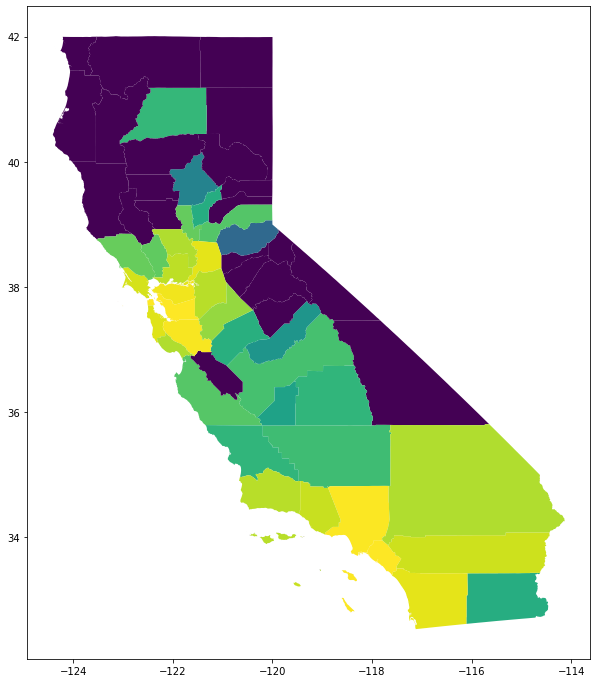

In [18]:
# do a simple geopandas plot of the percent of population in urban areas

ur_cbounds.plot(figsize=(12,12),column="PCT_UrbanArea")

## Make a cluster map layered with the easements and the county urbanization

In [19]:
# look at the projection of CCED dataframe

CCED.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World - 85°S to 85°N
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [20]:
# trim the dataset

CCED_trimmed = CCED[['sitename','esmthldr','eholdtyp','county','gis_acres','year_est','geometry']]
CCED_trimmed.head()

,sitename,esmthldr,eholdtyp,county,gis_acres,year_est,geometry
0,Forest Service Easement,United States Forest Service,Federal,San Diego,479.275130,1971,MULTIPOLYGON Z (((-12986180.651 3863101.889 0....
1,Forest Service Easement,United States Forest Service,Federal,San Diego,212.572028,1969,"POLYGON Z ((-13004703.942 3936729.412 0.000, -..."
2,Forest Service Easement,United States Forest Service,Federal,Riverside,78.358309,1969,"POLYGON Z ((-12985843.064 3982453.578 0.000, -..."
3,Forest Service Easement,United States Forest Service,Federal,San Bernardino,23.335541,1992,"POLYGON Z ((-13046839.601 4059743.122 0.000, -..."
4,Forest Service Easement,United States Forest Service,Federal,El Dorado,0.524050,1981,MULTIPOLYGON Z (((-13359781.503 4702478.829 0....


In [21]:
# make a copy that has the polygons of the easement boundaries converted to center points
# make a new dataframe and name the new columns cent_lat and _lon

CCED_points = CCED_trimmed.copy()
CCED_points["geometry"] = CCED_points["geometry"].centroid
CCED_points['cent_lon'] = CCED_points.geometry.x
CCED_points['cent_lat'] = CCED_points.geometry.y
CCED_points.head()

,sitename,esmthldr,eholdtyp,county,gis_acres,year_est,geometry,cent_lon,cent_lat
0,Forest Service Easement,United States Forest Service,Federal,San Diego,479.275130,1971,POINT (-12987009.331 3861418.083),-1.298701e+07,3.861418e+06
1,Forest Service Easement,United States Forest Service,Federal,San Diego,212.572028,1969,POINT (-13004227.527 3937315.065),-1.300423e+07,3.937315e+06
2,Forest Service Easement,United States Forest Service,Federal,Riverside,78.358309,1969,POINT (-12986313.853 3982695.203),-1.298631e+07,3.982695e+06
3,Forest Service Easement,United States Forest Service,Federal,San Bernardino,23.335541,1992,POINT (-13046611.435 4059609.976),-1.304661e+07,4.059610e+06
4,Forest Service Easement,United States Forest Service,Federal,El Dorado,0.524050,1981,POINT (-13360829.408 4702945.992),-1.336083e+07,4.702946e+06


In [22]:
# define the point geometry into webmercator

CCED_points = gpd.GeoDataFrame(CCED_points, 
                         crs='EPSG:3857',
                         geometry=gpd.points_from_xy(CCED_points.cent_lon, CCED_points.cent_lat))

In [23]:
# change the projection into 4326

CCED_points = CCED_points.to_crs('EPSG:4326')

In [24]:
# redefine the centroids again so they're in 4326

CCED_points['cent_lon'] = CCED_points.geometry.x
CCED_points['cent_lat'] = CCED_points.geometry.y

In [25]:
# get the bounding box coordinates

minx, miny, maxx, maxy = CCED_points.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-124.34265329342328
-114.60238995152626
32.54387182607664
41.99893311302417


In [26]:
# get center lon

center_lon = (maxx-minx)/2+minx
center_lon

-119.47252162247477

In [27]:
# get center lat
center_lat = (maxy-miny)/2+miny
center_lat

37.27140246955041

In [28]:
# folium map centered based on the easement data
m = folium.Map(location=[center_lat, center_lon],tiles='cartodbpositron',zoom_start=5)

In [29]:
marker_cluster=MarkerCluster(name='CA Easements on Private Land').add_to(m)

for index, row in CCED_points.iterrows():
    popup='<strong>'+str(row.sitename)+'</strong><hr>'+'Easementholder: '+str(row.esmthldr)+'</strong><hr>'+'Year Est: '+str(row.year_est)
    print(popup)
    print(row.cent_lat)
    folium.Marker(
        location=[row.cent_lat,row.cent_lon],
        tooltip=row.sitename,
        icon=folium.Icon(color='red')).add_to(marker_cluster)

<strong>Forest Service Easement</strong><hr>Easementholder: United States Forest Service</strong><hr>Year Est: 1971
32.74433810364209
<strong>Forest Service Easement</strong><hr>Easementholder: United States Forest Service</strong><hr>Year Est: 1969
33.31593903955345
<strong>Forest Service Easement</strong><hr>Easementholder: United States Forest Service</strong><hr>Year Est: 1969
33.655932485689384
<strong>Forest Service Easement</strong><hr>Easementholder: United States Forest Service</strong><hr>Year Est: 1992
34.229128047290956
<strong>Forest Service Easement</strong><hr>Easementholder: United States Forest Service</strong><hr>Year Est: 1981
38.86915185912784
<strong>Forest Service Easement</strong><hr>Easementholder: United States Forest Service</strong><hr>Year Est: 1981
38.811203271072465
<strong>Forest Service Easement</strong><hr>Easementholder: United States Forest Service</strong><hr>Year Est: 1981
38.83039773615738
<strong>Forest Service Easement</strong><hr>Easementholder:

In [30]:
# put the urban area population by county as a choropleth as a layer under the easement clusters

folium.Choropleth(
    ur_cbounds,
    data=ur_cbounds,
    key_on='feature.properties.Geo_NAME',
    columns=['Geo_NAME',"PCT_UrbanArea"],
    fill_color='PuBuGn',
    fill_opacity=0.4,
    line_opacity=0.1,
    legend_name="Percent Population in Urban Areas (2010 Census)").add_to(m)

folium.LayerControl().add_to(m)

m

# Make a function

I want the function to zoom into specific counties and show the polygon of the easement. Ideally, I want it to show:
(1) the county boundary
(2) the polygon of the easements
(3) color code the easements by easement holder type (pretty transparent)
(3) a legend for the type of easement holder

Later, I think it would be really good to have satellite imagery as the basemap when zooming into specific counties. It could show if there's mismatch as far as where there's supposed to be an easement, but maybe its developed instead of being a farm or other open space.

See next notebook "Clean_Midterm_cont" for function